In [1]:
import scanpy as sc 
import pandas as pd 
import numpy as np 

/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/anndata/utils.py:434: FutureWarning: Importing read_

In [2]:
import scSLAT
from scSLAT.model import Cal_Spatial_Net, load_anndatas, run_SLAT, spatial_match
from scSLAT.viz import match_3D_multi, hist, Sankey

/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/torch_geometric/typing.py:124: UserWarning: An issue occurred while importing 'torch-sparse'. Disabling its usage. Stacktrace: /ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/torch_sparse/_version_cpu.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  warnings.warn(f"An issue occurred while importing 'torch-sparse'. "


In [3]:
test_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_14.h5ad')
test_adata

AnnData object with n_obs × n_vars = 6102 × 3058
    obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'spatial', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [4]:
ref_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
ref_adata

AnnData object with n_obs × n_vars = 8509 × 3058
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'pca', 'received_ligands', 'received_ligands_tfl', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
    varm: 'PCs'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [5]:
ref_embed = pd.read_parquet('/ix/djishnu/shared/djishnu_kor11/banksy_outputs/mouse_kidney_13_embedding.parquet')
ref_embed.shape

(8509, 9174)

In [6]:
test_embed = pd.read_parquet('/ix/djishnu/shared/djishnu_kor11/banksy_outputs/mouse_kidney_14_embedding.parquet')
test_embed.shape

(6102, 9174)

In [7]:
xI = test_adata.obsm['spatial'][:, 0]
yI = test_adata.obsm['spatial'][:, 1]
xJ = ref_adata.obsm['spatial'][:, 0]
yJ= ref_adata.obsm['spatial'][:, 1]

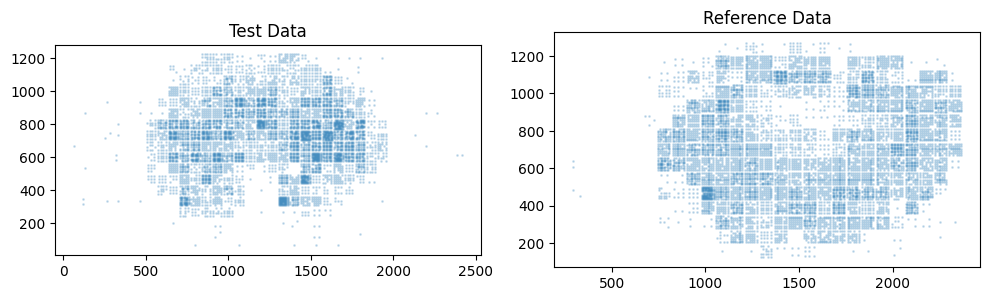

In [8]:
import matplotlib.pyplot as plt
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))

# Plot test data
ax1.scatter(xI, yI, s=1, alpha=0.2)
ax1.set_title('Test Data')
ax1.set_aspect('equal')

# Plot reference data  
ax2.scatter(xJ, yJ, s=1, alpha=0.2)
ax2.set_title('Reference Data')
ax2.set_aspect('equal')

plt.tight_layout()


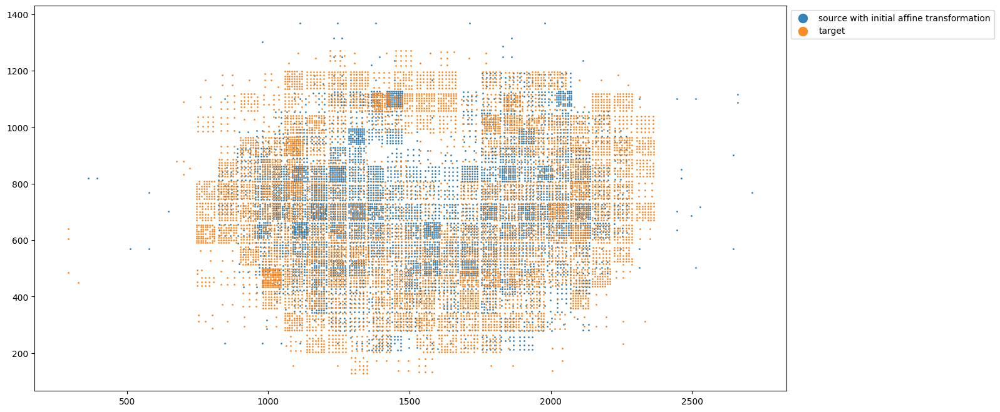

In [10]:
import matplotlib.pyplot as plt 

theta_deg = 180
theta0 = (np.pi/180)*-theta_deg

#rotation matrix
#rotates about the origin
L = np.array([[np.cos(theta0),-np.sin(theta0)],
              [np.sin(theta0),np.cos(theta0)]])

source_L = np.matmul(L , np.array([xI, yI]))
xI_L = source_L[0] 
yI_L = source_L[1] 

#translation matrix
#effectively makes the rotation about the centroid of I (i.e the means of xI and yI])
#and also moves the centroid of I to the centroid of J
T = np.array([ np.mean(xI)- np.cos(theta0)*np.mean(xI) +np.sin(theta0)*np.mean(yI) - (np.mean(xI)-np.mean(xJ)),
              np.mean(yI)- np.sin(theta0)*np.mean(xI) -np.cos(theta0)*np.mean(yI) - (np.mean(yI)-np.mean(yJ))])

shrink = 1
xI_L_T = xI_L * shrink + T[0] 
yI_L_T = yI_L * shrink + T[1]


fig,ax = plt.subplots(figsize=(25,8))
ax.scatter(xI_L_T,yI_L_T,s=1,alpha=0.9, label='source with initial affine transformation')
ax.scatter(xJ,yJ,s=1,alpha=0.9, label = 'target')
ax.legend(markerscale = 10, loc='upper left', bbox_to_anchor=(1, 1))
ax.set_aspect('equal', adjustable='box')

In [11]:
# doesnt have to be perfect since SLAT doesn't need them to be aligned
# it's just easier to find a good crop

test_adata.obsm['spatial'] = np.stack([xI_L_T, yI_L_T]).T

In [12]:
adata2 = test_adata 
adata1 = ref_adata

adata1, adata2

(AnnData object with n_obs × n_vars = 8509 × 3058
     obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
     uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'pca', 'received_ligands', 'received_ligands_tfl', 'umap'
     obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
     varm: 'PCs'
     layers: 'imputed_count', 'normalized_count', 'raw_count'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 6102 × 3058
     obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
     var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', '

### Use the Banksy embedding as features

In [13]:
test_embed = test_embed.reindex(test_adata.obs.index, axis=0)
test_embed = test_embed.reindex(ref_embed.columns, axis=1)

ref_embed = ref_embed.reindex(ref_adata.obs.index, axis=0)

In [14]:
test_adata = sc.AnnData(
    X = test_embed.values,
    obs = test_adata.obs,
    var = pd.DataFrame(index=test_embed.columns),
    obsm = test_adata.obsm
)

ref_adata = sc.AnnData(
    X = ref_embed.values,
    obs = ref_adata.obs,
    var = pd.DataFrame(index=ref_embed.columns),
    obsm = ref_adata.obsm
)

In [15]:
test_adata.X.max(), ref_adata.X.max()

(69.86271667480469, 55.80235290527344)

In [16]:
test_adata.X.min(), ref_adata.X.min()

(-4.354429244995117, -6.766073226928711)

### Run scSLAT

In [17]:
adata2 = test_adata
adata1 = ref_adata

adata1.X.min(), adata2.X.min()

(-6.766073226928711, -4.354429244995117)

In [18]:
Cal_Spatial_Net(adata1, k_cutoff=10, model='KNN')
Cal_Spatial_Net(adata2, k_cutoff=10, model='KNN')

Calculating spatial neighbor graph ...
The graph contains 94277 edges, 8509 cells.
11.079680338465154 neighbors per cell on average.
Calculating spatial neighbor graph ...
The graph contains 68612 edges, 6102 cells.
11.244182235332678 neighbors per cell on average.


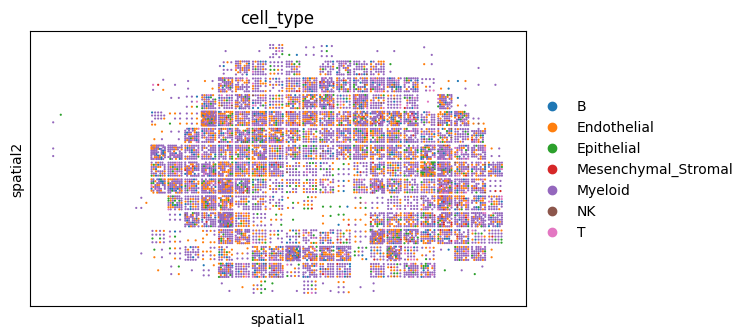

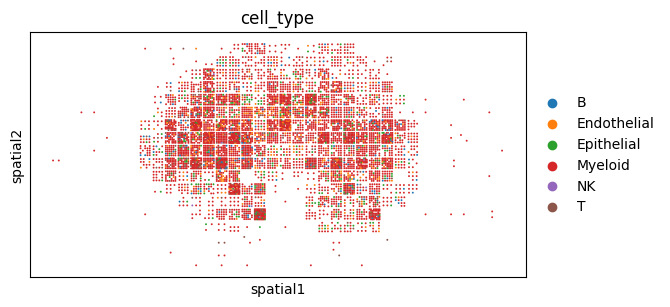

In [19]:
sc.pl.spatial(adata1, color="cell_type", spot_size=10)
sc.pl.spatial(adata2, color="cell_type", spot_size=10)

In [20]:
edges, features = load_anndatas([adata1, adata2], feature='raw', check_order=False)

Use raw feature to format graph


In [21]:
embd0, embd1, time = run_SLAT(features, edges)

GPU is not available
Running
Training model time: 465.97


In [22]:
best, index, distance = spatial_match([embd0, embd1], adatas=[adata1,adata2], reorder=False)

In [23]:
adata1.obs['annotation'] = adata1.obs['cell_type']
adata2.obs['annotation'] = adata2.obs['cell_type']

In [24]:
adata1_df = pd.DataFrame({'index': range(embd0.shape[0]),
                        'x': adata1.obsm['spatial'][:,0],
                        'y': adata1.obsm['spatial'][:,1],
                        'celltype': adata1.obs['annotation']})
adata2_df = pd.DataFrame({'index': range(embd1.shape[0]),
                        'x': adata2.obsm['spatial'][:,0],
                        'y': adata2.obsm['spatial'][:,1],
                        'celltype': adata2.obs['annotation']})

matching = np.array([range(index.shape[0]), best])
best_match = distance[:,0]

dataset1: 7 cell types; dataset2: 6 cell types; 
                    Total :7 celltypes; Overlap: 6 cell types 
                    Not overlap :[['Mesenchymal_Stromal']]
Subsampled 300 pairs from 6102


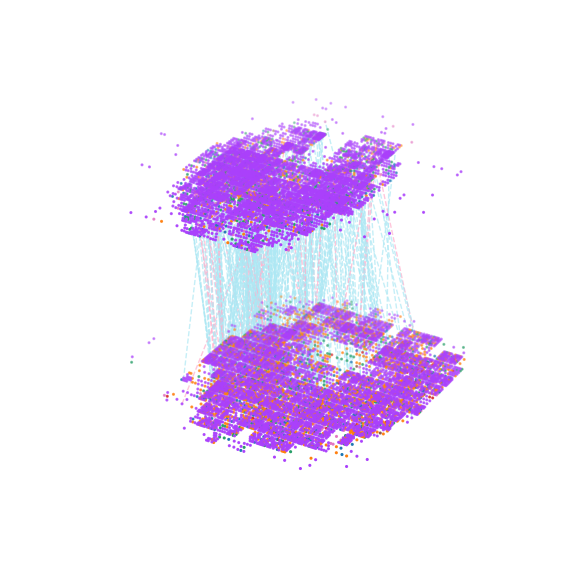

In [25]:
multi_align = match_3D_multi(adata1_df, adata2_df, matching,meta='celltype',
                            scale_coordinate=True, subsample_size=300)
multi_align.draw_3D(size=[7, 8], line_width=1, point_size=[1.5,1.5], hide_axis=True)

In [26]:
matching

array([[   0,    1,    2, ..., 6099, 6100, 6101],
       [1647, 7245, 7270, ..., 3538, 3646, 3147]])

In [27]:
test_cells = np.array(test_adata.obs_names)[matching[0]]
ref_cells = np.array(ref_adata.obs_names)[matching[1]]

pd.DataFrame(ref_cells, index=test_cells, columns=['reference_cell']).to_csv('matching_slat_banksy.csv')

### Check mapping

In [28]:
mapping = pd.read_csv('matching_slat_banksy.csv', index_col=0)
mapping.shape

(6102, 1)

In [29]:
mapping['reference_cell'].value_counts()

reference_cell
GAAGGACCACTTGGGC-13    34
GCTACCTCAACGACAG-13    34
CTGTACCTCGATTTCT-13    34
CTACATTAGCAACTCT-13    29
CTCTCGAAGCATGGGT-13    28
                       ..
TCACACCAGTAGCAAT-13     1
TCATCATCATCGGCCA-13     1
GGCACGTTCCACCCTA-13     1
TTTGACTGTTTGTGGT-13     1
AAGGTAATCACTTGGA-13     1
Name: count, Length: 2311, dtype: int64

In [30]:
mapping['ref_cell_type'] = mapping['reference_cell'].map(ref_adata.obs['cell_type'])
mapping['test_cell_type'] = mapping.index.map(test_adata.obs['cell_type'])


In [31]:
df3 = mapping

In [32]:
import plotly.graph_objects as go

# Prepare data for Sankey plot
source_labels = sorted(df3['test_cell_type'].unique())
target_labels = sorted(df3['ref_cell_type'].unique())

source = []
target = []
value = []

heatmap_data = df3.groupby(['test_cell_type', 'ref_cell_type']).size().unstack(fill_value=0)

for i, test_type in enumerate(source_labels):
    for j, ref_type in enumerate(target_labels):
        source.append(i)
        target.append(len(source_labels) + j)
        value.append(heatmap_data.loc[test_type, ref_type])

labels = source_labels + target_labels

# Assign colors to nodes
color_palette = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3', '#FF6692']
# Assign colors to nodes ensuring shared colors for matching labels
node_colors = []
label_to_color = {label: color_palette[i % len(color_palette)] for i, label in enumerate(set(target_labels) | set(source_labels))}
for label in labels:
    node_colors.append(label_to_color[label])


# Assign colors to links based on source node
link_colors = [node_colors[s] for s in source]

# Create Sankey plot
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels,
        color=node_colors
    ),
    link=dict(
        source=source,
        target=target,
        value=value,
        color=link_colors
    )
)])

fig.update_layout(
    title_text="test_cell_type mapped to ref_cell_type",
    font_size=10,
    height=800  # Increase the height of the plot
)
fig.show()

/tmp/ipykernel_19004/2063003311.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df3.groupby(['test_cell_type', 'ref_cell_type']).size().unstack(fill_value=0)


In [36]:
colors = ["#6588cd",
"#75ab3d",
"#ab62c0",
"#54a77a",
"#c85979",
"#b49142",
"#cc5d38"]
color_dict = dict(zip(ref_adata.obs['cell_type'].unique(), colors))

In [37]:
mapping

,reference_cell,ref_cell_type,test_cell_type
AAACCCAAGCCATTCA-1,ATCCATTAGAAAGCGA-13,Myeloid,Myeloid
AAACCCACAAATCAGA-1,TCTTAGTGTAACTAAG-13,Epithelial,Epithelial
AAACCCACAACTCATG-1,TCTTGCGGTGAGCCAA-13,Epithelial,Epithelial
AAACCCAGTACAGAAT-1,GACCAATAGATTCGCT-13,Myeloid,Myeloid
AAACCCAGTACGTGTT-1,TCTTTGACACACCGAC-13,Myeloid,Myeloid
...,...,...,...
TTTGTTGAGCATATGA-2,GGTCTGGTCAGTAGGG-13,Myeloid,Myeloid
TTTGTTGGTGCCCACA-2,ATCACAGGTCTGCAAT-13,Myeloid,Myeloid
TTTGTTGGTGGCCCAT-2,CTACATTAGCAACTCT-13,Myeloid,Myeloid
TTTGTTGTCCCAGGAC-2,CTCAAGATCCCTAGGG-13,Myeloid,Myeloid


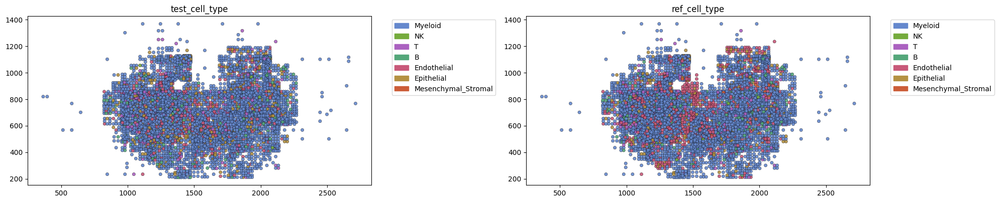

In [38]:
import matplotlib.patches as mpatches
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Create legend patches
legend_patches = [mpatches.Patch(color=color, label=cell_type) 
                 for cell_type, color in color_dict.items()]

# Plot test cell types
test_colors = [color_dict[ct] for ct in test_adata.obs['cell_type'].reindex(mapping.index)]
axs[0].scatter(
    test_adata.obsm['spatial'][:, 0],
    test_adata.obsm['spatial'][:, 1],
    s=20,
    alpha=0.9,
    c=test_colors,
    edgecolor='black',
    linewidth=0.3
)
axs[0].set_title('test_cell_type')
axs[0].set_aspect('equal')
axs[0].legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

# Plot ref cell types  
ref_colors = [color_dict[ct] for ct in mapping['ref_cell_type']]
axs[1].scatter(
    test_adata.obsm['spatial'][:, 0],
    test_adata.obsm['spatial'][:, 1],
    s=20,
    alpha=0.9,
    c=ref_colors,
    edgecolor='black',
    linewidth=0.3
)
axs[1].set_title('ref_cell_type')
axs[1].set_aspect('equal')
axs[1].legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()

### Banksy clustering

In [ ]:
# I cannot find the notebook where I made the Banksy embeddings

In [72]:
import sys
sys.path.append('/ix/djishnu/alw399/SpaceOracle/src/Banksy_py')
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [73]:
from banksy_utils.load_data import load_adata, display_adata

In [101]:
# adata = test_adata
adata = ref_adata
raw_x, raw_y = adata.obsm['spatial'][:, 0], adata.obsm['spatial'][:, 1]

In [102]:
from banksy.main import median_dist_to_nearest_neighbour

In [103]:
plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = 'spatial')


Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.10 s ----



In [104]:
adata.obs['x'] = raw_x
adata.obs['y'] = raw_y


Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.10 s ----

---- Ran generate_spatial_distance_graph in 0.31 s ----

---- Ran row_normalize in 0.07 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.90 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 19.565594803123464, mode = 19.829227800515174

---- Ran plot_edge_histogram in 0.21 s ----


Edge weights (weights between cells): median = 0.05672889861803235, mode = 0.03820283940351443

---- Ran plot_edge_histogram in 0.17 s ----

---- Ran generate_spatial_distance_graph in 0.19 s ----

---- Ran theta_from_spatial_graph in 0.09 s ----

---- Ran row_normalize in 0.04 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.58 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 26.25000000000057, mode = 24.974317988793167

---- Ran plot_edge_histogram in 0.08 s ----


Edge weights (wei

/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/matplotlib/cbook.py:1719: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/numpy/lib/histograms.py:841: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/matplotlib/axes/_axes.py:7127: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16
/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/matplotlib/cbook.py:1355: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


----- Plotting Weights Graph -----
Maximum weight: 0.16494463116900848

---- Ran plot_graph_weights in 2.78 s ----

Maximum weight: (0.08535049653907315+0j)

---- Ran plot_graph_weights in 3.86 s ----

----- Plotting theta Graph -----


/ix3/djishnu/alw399/envs/penguin/lib/python3.10/site-packages/matplotlib/collections.py:430: ComplexWarning: Casting complex values to real discards the imaginary part
  renderer.draw_path_collection(


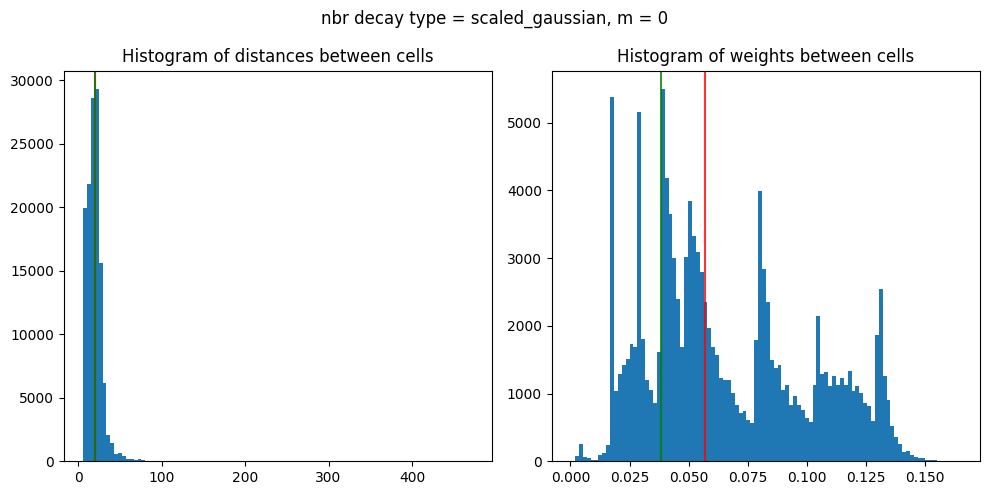

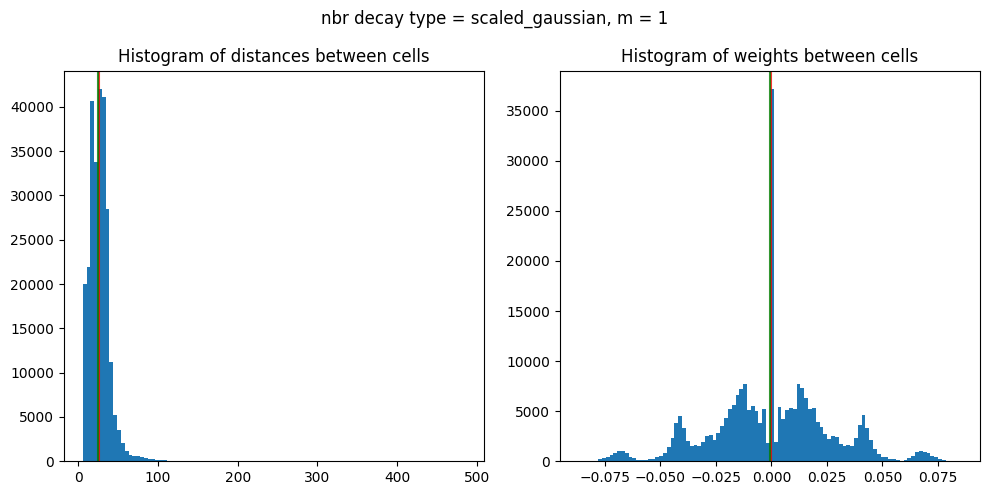

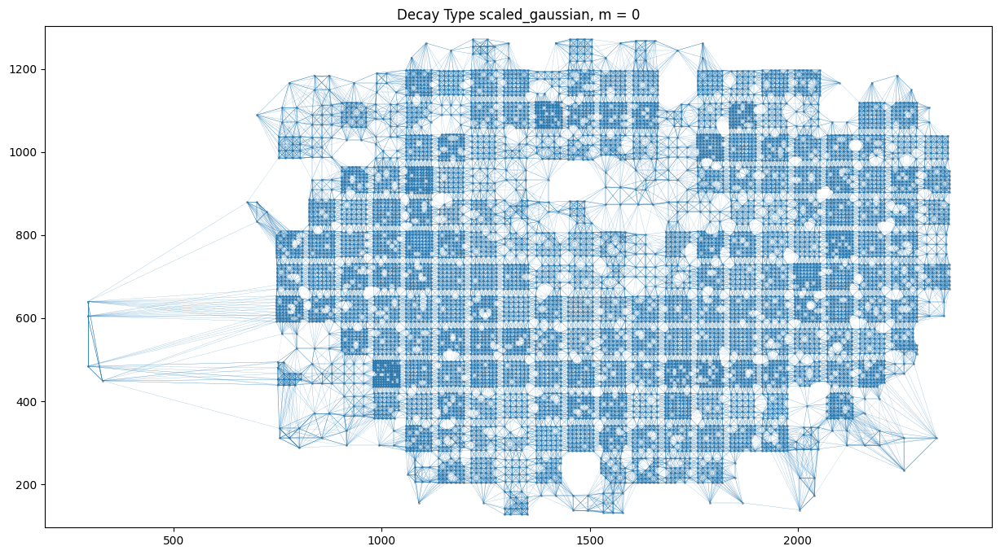

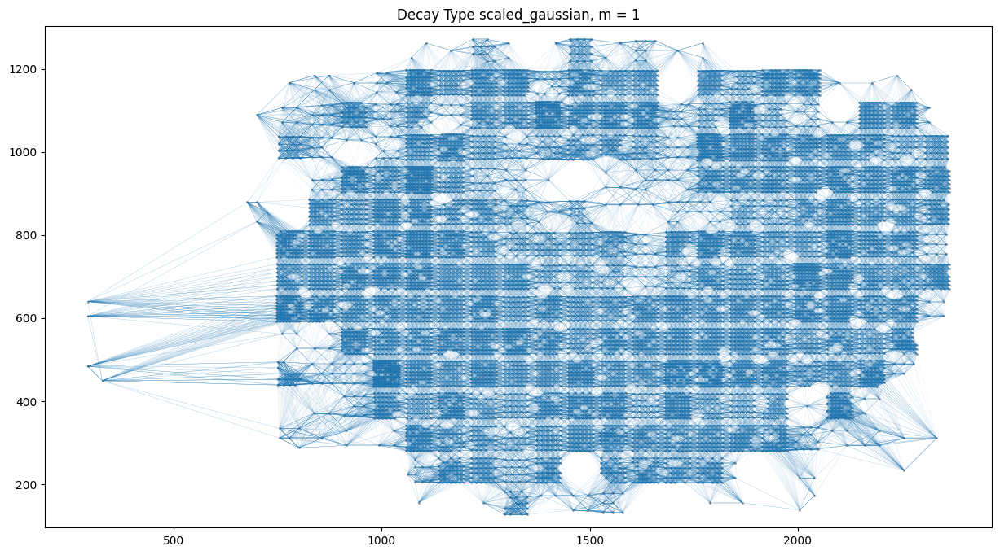

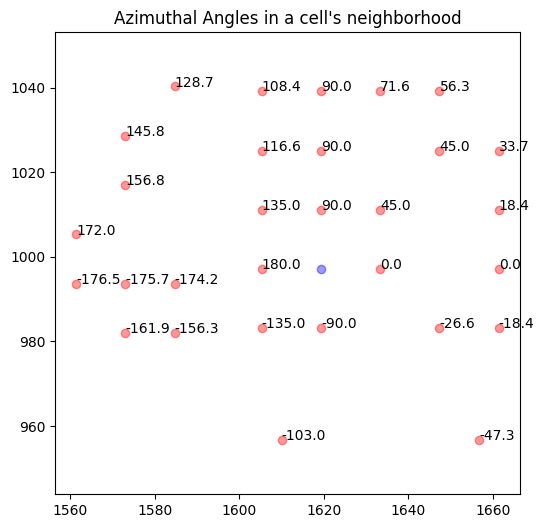

In [105]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    ('x', 'y', 'spatial'),
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

In [106]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
# resolutions = [0.6]  # clustering resolution for UMAP
resolutions = [0.5, 1.0, 1.5]
pca_dims = [50]  # Dimensionality in which PCA reduces to
lambda_list = [0.1, 0.2]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)
banksy_matrix

Runtime Apr-17-2025-13-39

3058 genes to be analysed:
Gene List:
Index(['Sox17', 'St18', 'Prex2', 'Lactb2', 'Kcnb2', 'Stau2', 'Pi15',
       'Crispld1', 'Tfap2b', 'Pkhd1',
       ...
       'Gpm6b', 'Ofd1', 'Egfl6', 'Tmsb4x', 'Tlr8', 'Tlr7', 'Frmpd4', 'Arhgap6',
       'Amelx', 'Mid1'],
      dtype='object', length=3058)

Check if X contains only finite (non-NAN) values
Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <8509x8509 sparse matrix of type '<class 'numpy.float64'>'
	with 127635 stored elements in Compressed Sparse Row format>, 1: <8509x8509 sparse matrix of type '<class 'numpy.complex128'>'
	with 255270 stored elements in Compressed Sparse Row format>}}



Nbr matrix | Mean: 0.59 | Std: 4.75
Size of Nbr | Shape: (8509, 3058)
Top 3 entries of Nbr Mat:

[[0.         0.         0.2310978 ]
 [0.         0.03673701 3.1193756 ]
 [4.31899542 0.91425081 3.63887903]]

AGF matrix | Mean: 0.23 | Std: 1.45
Size of AGF mat (m = 1) | Shape: (8509, 3058)
Top entries of AGF:
[[0.00940352 0.         0.25874461]
 [0.         0.01779757 1.46019643]
 [2.601691   0.94659997 1.80458351]]
Ran 'Create BANKSY Matrix' in 0.11 mins

Cell by gene matrix has shape (8509, 3058)

Scale factors squared: [0.9        0.06666667 0.03333333]
Scale factors: [0.9486833  0.25819889 0.18257419]
Shape of BANKSY matrix: (8509, 9174)
Type of banksy_matrix: <class 'anndata._core.anndata.AnnData'>

Scale factors squared: [0.8        0.13333333 0.06666667]
Scale factors: [0.89442719 0.36514837 0.25819889]
Shape of BANKSY matrix: (8509, 9174)
Type of banksy_matrix: <class 'anndata._core.anndata.AnnData'>



AnnData object with n_obs × n_vars = 8509 × 9174
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int', 'x', 'y'
    var: 'is_nbr', 'k'

In [107]:
from banksy.main import concatenate_all

banksy_dict["nonspatial"] = {
    # Here we simply append the nonspatial matrix (adata.X) to obtain the nonspatial clustering results
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

print(banksy_dict['nonspatial'][0.0]['adata'])

Scale factors squared: [1.]
Scale factors: [1.]
AnnData object with n_obs × n_vars = 8509 × 3058
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int', 'x', 'y'
    var: 'is_nbr', 'k'


In [108]:
import gc
gc.collect()

32

In [109]:
from banksy_utils.umap_pca import pca_umap

pca_umap(
    banksy_dict,
    pca_dims = pca_dims,
    add_umap = True,
    plt_remaining_var = False,
)

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.1)

Setting the total number of PC = 50
Original shape of matrix: (8509, 9174)
Reduced shape of matrix: (8509, 50)
------------------------------------------------------------
min_value = -183.3804866804854, mean = -4.275448122096266e-18, max = 242.55899722748367

Conducting UMAP and adding embeddings to adata.obsm["reduced_pc_50_umap"]
UMAP embedding
------------------------------------------------------------
shape: (8509, 2)


AxisArrays with keys: reduced_pc_50, reduced_pc_50_umap

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.2)

Setting the total number of PC = 50
Original shape of matrix: (8509, 9174)
Reduced shape of matrix: (8509, 50)
------------------------------------------------------------
min_value = -132.07061067759162, mean = -2.5385473224946583e-18, max = 202.69042614425854

Conducting UMAP and adding embeddings to adata.obsm["red

In [110]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50, # k_expr: number of neighbours in expression (BANKSY embedding or non-spatial) space
    num_iterations = -1, # run to convergenece
    partition_seed = 42,
    match_labels = True,
)

Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.1
reduced_pc_50 

reduced_pc_50_umap 

PCA dims to analyse: [50]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.1, PCA dimensions = 50)


Nearest-neighbour weighted graph (dtype: float64, shape: (8509, 8509)) has 425450 nonzero entries.
---- Ran find_nn in 8.60 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (8509, 8509)) has 425450 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 4412979 to 424082.


Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (8509, 8509)) has 411966 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (8509, 8509)) has 411966 nonzero entries.

sNN graph data:
[18 14 32 ... 19 16 14]

---- Ran shared_nn in 0.94 s ----


-- Multiplying sNN connectivity by weights --


shared NN w

/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:398: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  expand_labels(label_list[sort_indices[0]],
/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:414: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  current_label = label_list[index]


,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc50_nc0.00_r0.50,nonspatial,0.0,50,0.5,10,"Label object:\nNumber of labels: 10, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 10, number of..."
nonspatial_pc50_nc0.00_r1.00,nonspatial,0.0,50,1.0,19,"Label object:\nNumber of labels: 19, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 19, number of..."
nonspatial_pc50_nc0.00_r1.50,nonspatial,0.0,50,1.5,21,"Label object:\nNumber of labels: 21, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 21, number of..."
scaled_gaussian_pc50_nc0.10_r0.50,scaled_gaussian,0.1,50,0.5,12,"Label object:\nNumber of labels: 12, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 12, number of..."
scaled_gaussian_pc50_nc0.10_r1.00,scaled_gaussian,0.1,50,1.0,17,"Label object:\nNumber of labels: 17, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 17, number of..."
scaled_gaussian_pc50_nc0.10_r1.50,scaled_gaussian,0.1,50,1.5,19,"Label object:\nNumber of labels: 19, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 19, number of..."
scaled_gaussian_pc50_nc0.20_r0.50,scaled_gaussian,0.2,50,0.5,12,"Label object:\nNumber of labels: 12, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 12, number of..."
scaled_gaussian_pc50_nc0.20_r1.00,scaled_gaussian,0.2,50,1.0,17,"Label object:\nNumber of labels: 17, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 17, number of..."
scaled_gaussian_pc50_nc0.20_r1.50,scaled_gaussian,0.2,50,1.5,23,"Label object:\nNumber of labels: 23, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 23, number of..."


number of labels: 10
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 10
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 10
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((10, 8509) x (8509, 8509) x (8509, 10))

number of labels: 19
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 19
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 19
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((19, 8509) x (8509, 8509) x (8509, 19))

number of labels: 21
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 21
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 21
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((21, 8509) x (8509, 8509) x (8509, 21))

numb

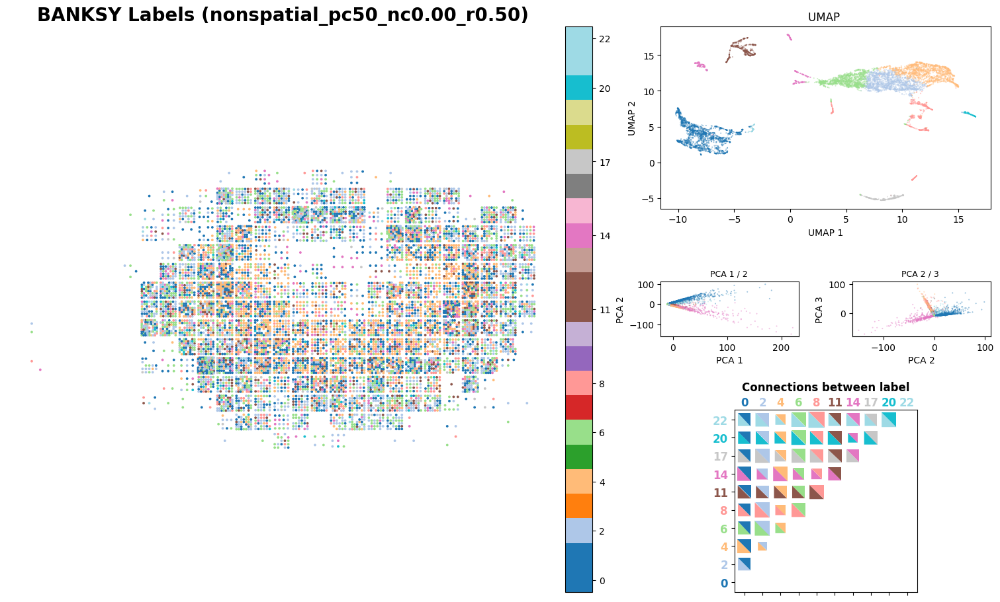

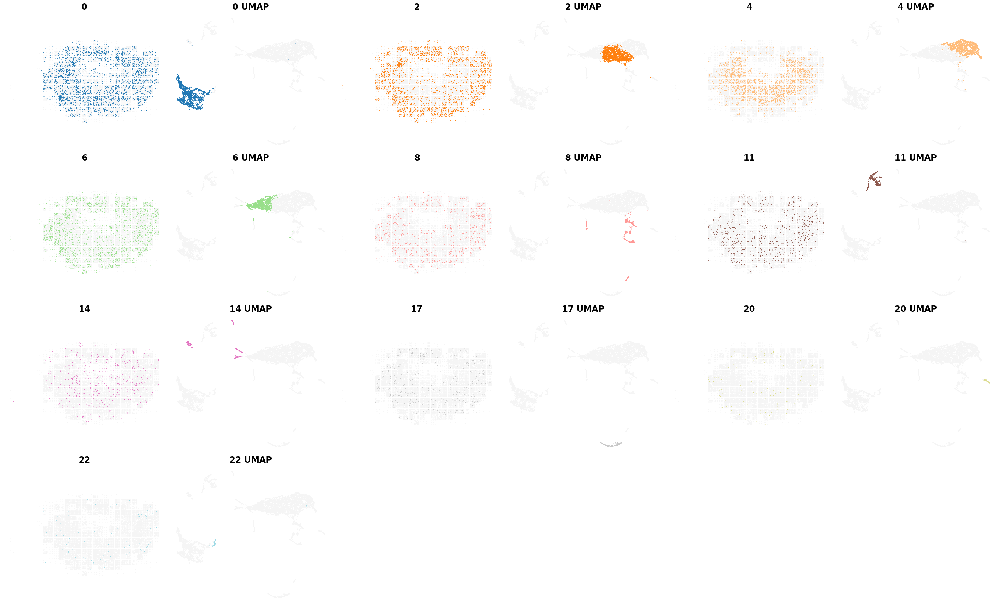

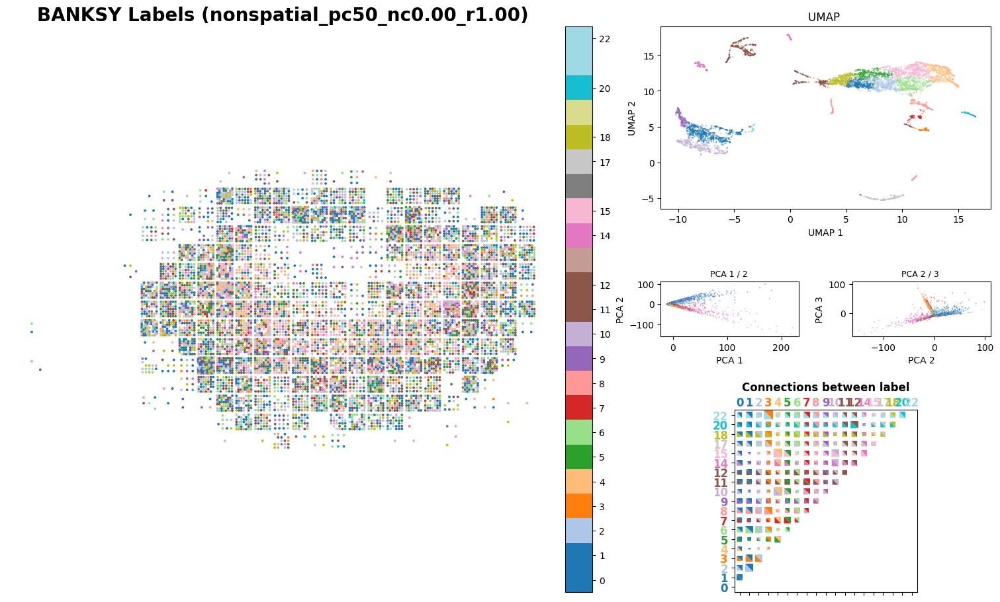

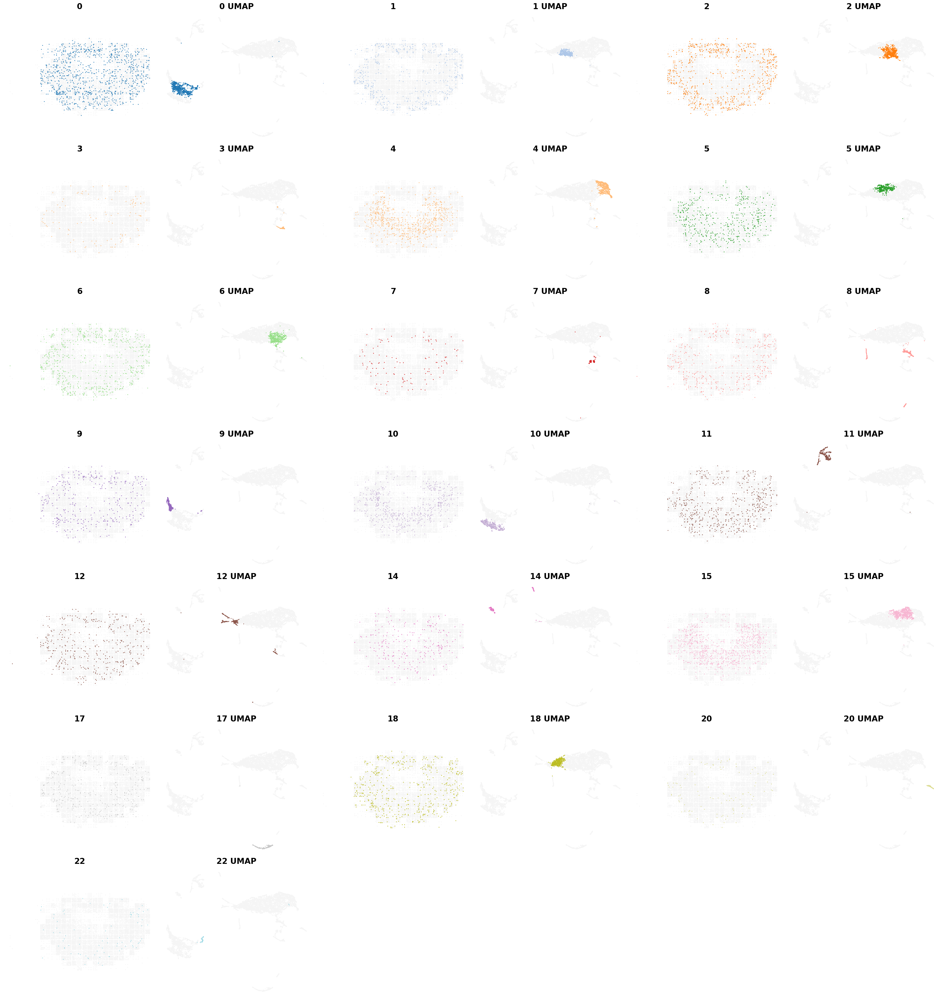

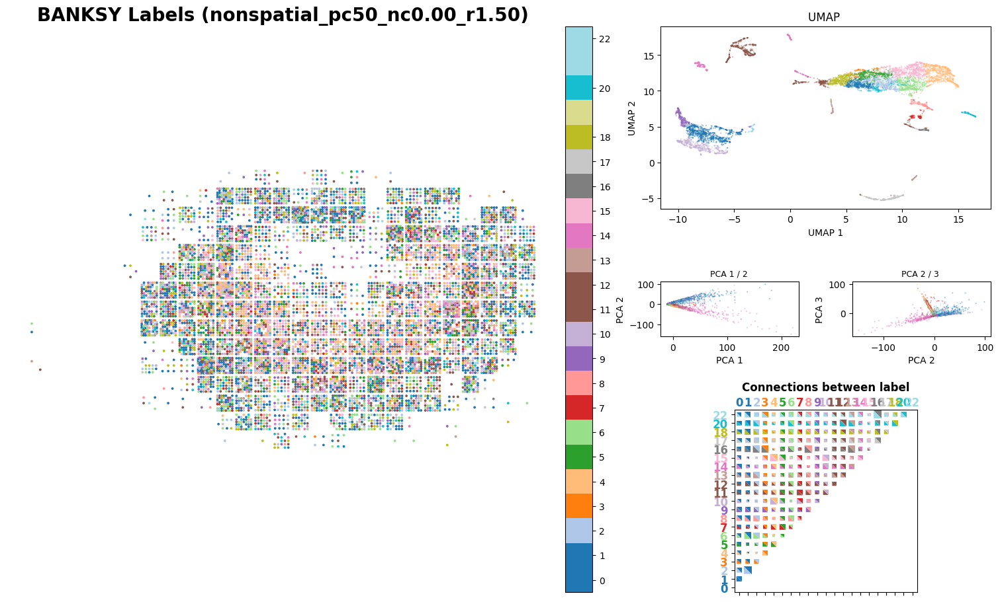

...

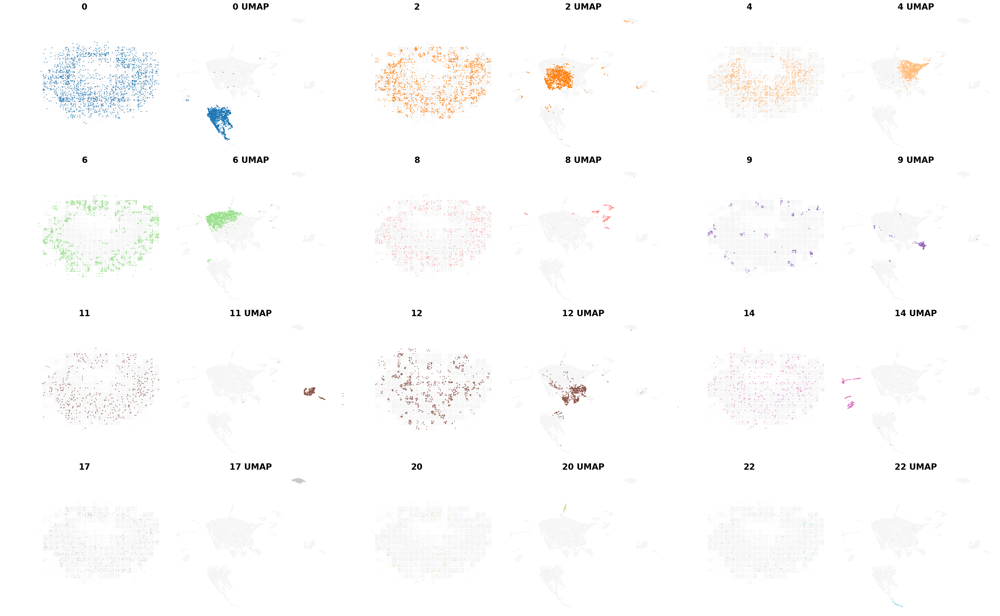

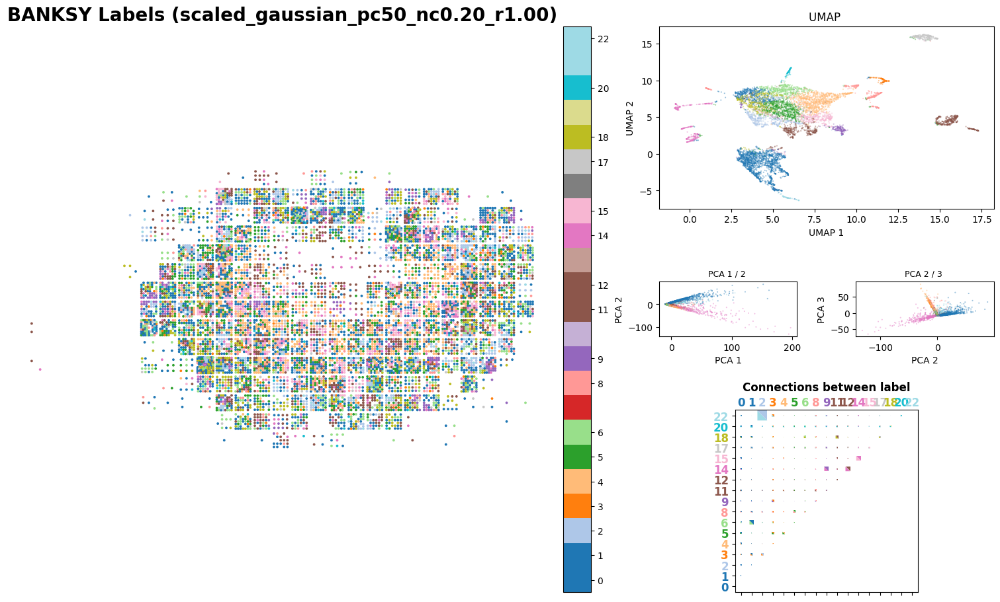

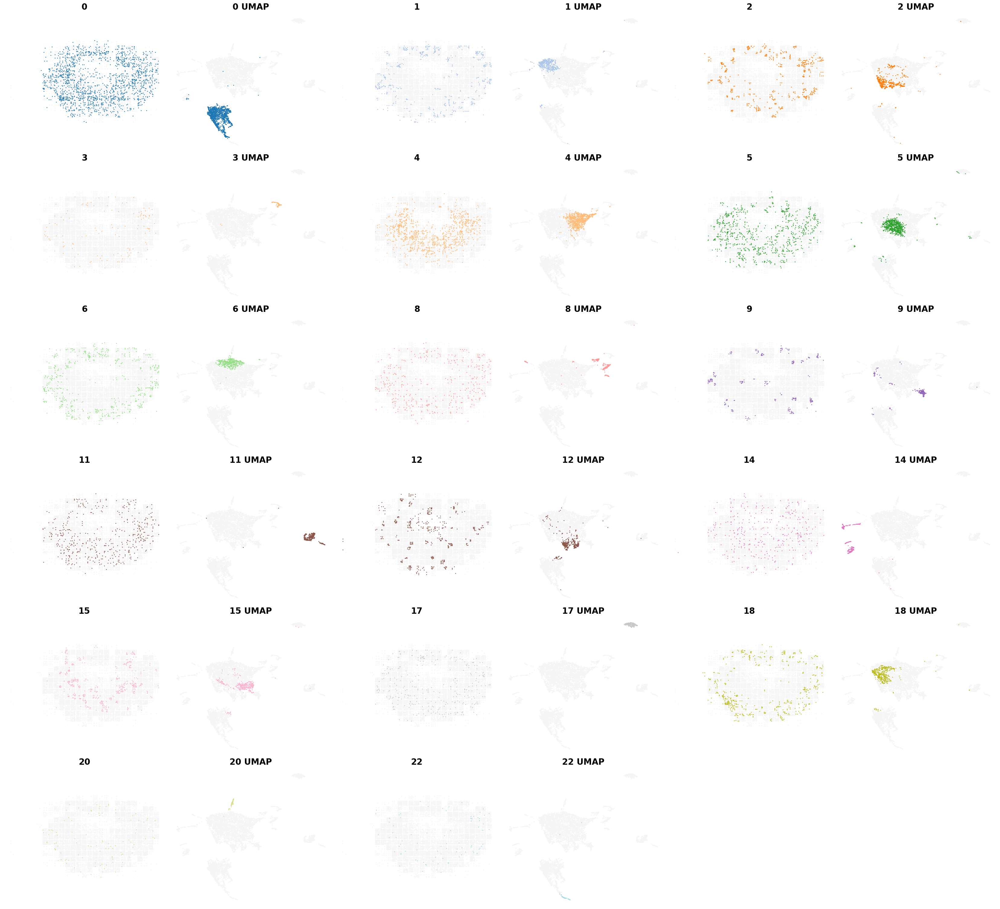

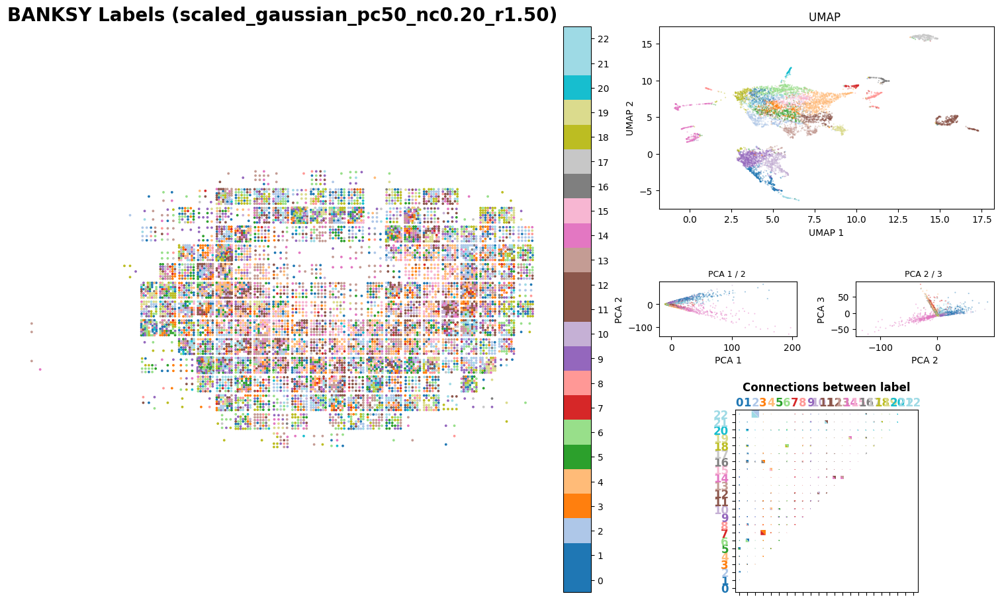

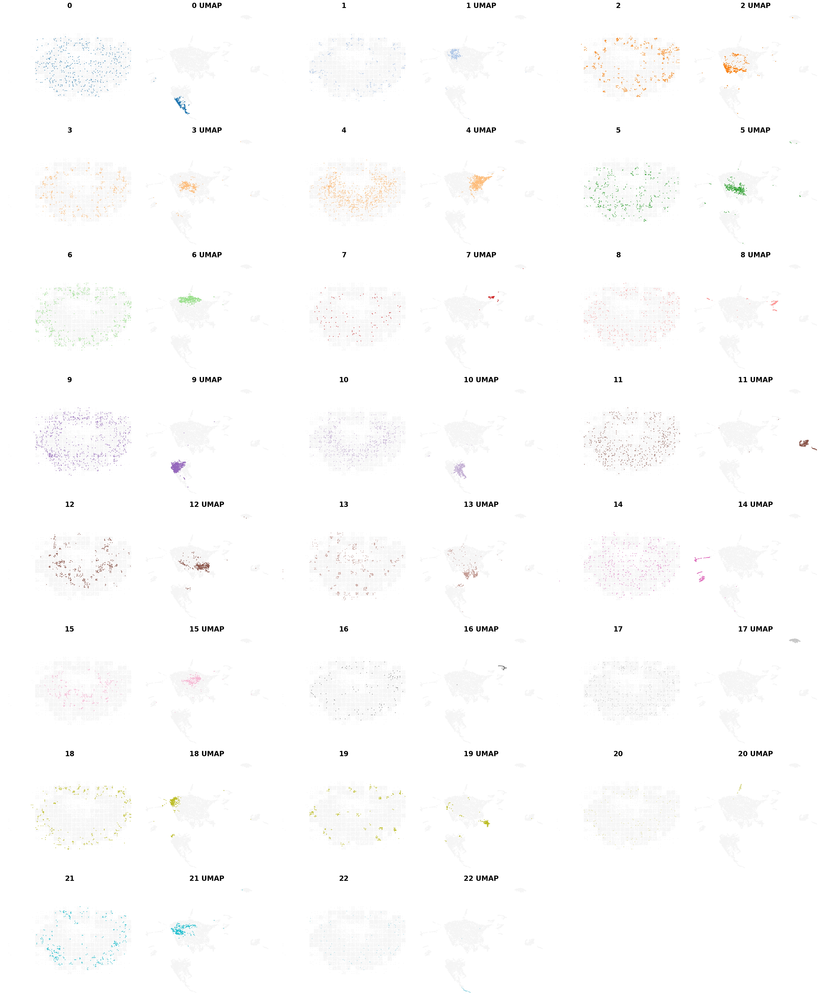

In [111]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = ('x', 'y', 'spatial'),
    max_num_labels  =  max_num_labels, 
    save_path = '/tmp',
    save_fig = False
)

In [112]:
# label = 'scaled_gaussian_pc50_nc0.10_r1.00'
label = 'scaled_gaussian_pc50_nc0.20_r1.00'

In [113]:
save_df = pd.DataFrame(results_df.loc[label].adata.obs[f'labels_{label}'])
save_df.columns = ['banksy_cluster']

umap_coords = results_df.loc[label].adata.obsm['reduced_pc_50_umap']
save_df['x_umap'] = umap_coords[:, 0]
save_df['y_umap'] = umap_coords[:, 1]
# save_df.to_csv('banksy_mouse_kidney_14.csv')
save_df.to_csv('banksy_mouse_kidney_13.csv')
save_df

,banksy_cluster,x_umap,y_umap
AAACCCAAGAGGGTCT-13,4,7.074156,7.119772
AAACCCAAGCGTGTTT-13,11,14.748532,4.472886
AAACCCAAGGTGATAT-13,4,7.108496,3.926453
AAACCCAAGTCTAACC-13,11,15.991267,4.948157
AAACCCAAGTGCCCGT-13,17,14.302094,16.157007
...,...,...,...
TTTGTTGGTAGGATAT-13,14,-0.348609,6.551971
TTTGTTGGTATGCGTT-13,5,6.515358,5.587703
TTTGTTGGTTGAGGAC-13,18,3.986618,6.260031
TTTGTTGTCACTGGTA-13,20,5.924165,11.153895


In [114]:
save_df['banksy_cluster'].value_counts()

banksy_cluster
0     1647
4     1048
5      794
6      583
1      529
2      522
18     506
11     454
15     452
12     432
8      368
14     340
17     299
9      224
3      121
20     106
22      84
Name: count, dtype: int64